In [1]:
from biological_fuzzy_logic_networks.draw import draw_BioFuzzNet
from biological_fuzzy_logic_networks.DREAM.DREAMBioFuzzNet import DREAMBioFuzzNet
from biological_fuzzy_logic_networks.DREAM.DREAMdataset import DREAMBioFuzzDataset
from biological_fuzzy_logic_networks.utils import read_sif

import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split
import torch

import seaborn as sns
import matplotlib.pyplot as plt
import pickle

/dccstor/ipc1/.conda/envs/biofuzznet2/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
inhibitor_mapping = {"EGF": np.nan, "full" : np.nan,
                     "iEGFR": "EGFR", "iMEK": 'MEK12_S221', 
                     "iPI3K": "PI3K", "iPKC": "PKC"}
node_names_to_data_mapping = {
    'EGF': 'EGF',
    'SERUM' : 'SERUM'    , 
    'b.CATENIN' : 'b-catenin', 
    'cleavedCas' : 'cleavedCas', 
#     'CyclinB' : , 
#     'GAPDH' : , 
#     'IdU' :  , 
#     'Ki.67' : , 
    'p.4EBP1' : '4EBP1', 
    'p.Akt.Ser473.' : 'AKT_S473' , 
    'p.AKT.Thr308.' : 'AKT_T308' , 
    'p.AMPK' : 'AMPK', 
    'p.BTK' : 'BTK', 
    'p.CREB' : 'CREB', 
    'p.ERK' : 'ERK12', 
    'p.FAK' : 'FAK', 
    'p.GSK3b' : 'GSK3B', 
    'p.H3' : 'H3', 
#     'p.HER2' : , 
    'p.JNK' : 'JNK', 
    'p.MAP2K3' : 'MAP3Ks', 
    'p.MAPKAPK2' : 'MAPKAPK2', 
    'p.MEK' : 'MEK12_S221', 
    'p.MKK3.MKK6' : 'MKK36', 
    'p.MKK4' : 'MKK4', 
    'p.NFkB' : 'NFkB', 
    'p.p38' : 'p38', 
    'p.p53' : 'p53', 
    'p.p90RSK' : 'p90RSK', 
    'p.PDPK1' : 'PDPK1', 
    'p.PLCg2' : 'PLCg2', 
    'p.RB' : 'RB', 
    'p.S6' : 'S6', 
    'p.S6K' : 'p70S6K', 
    'p.SMAD23' : 'SMAD23'   , 
    'p.SRC' : 'SRC', 
    'p.STAT1' : 'STAT1', 
    'p.STAT3' : 'STAT3', 
    'p.STAT5' : 'STAT5'}

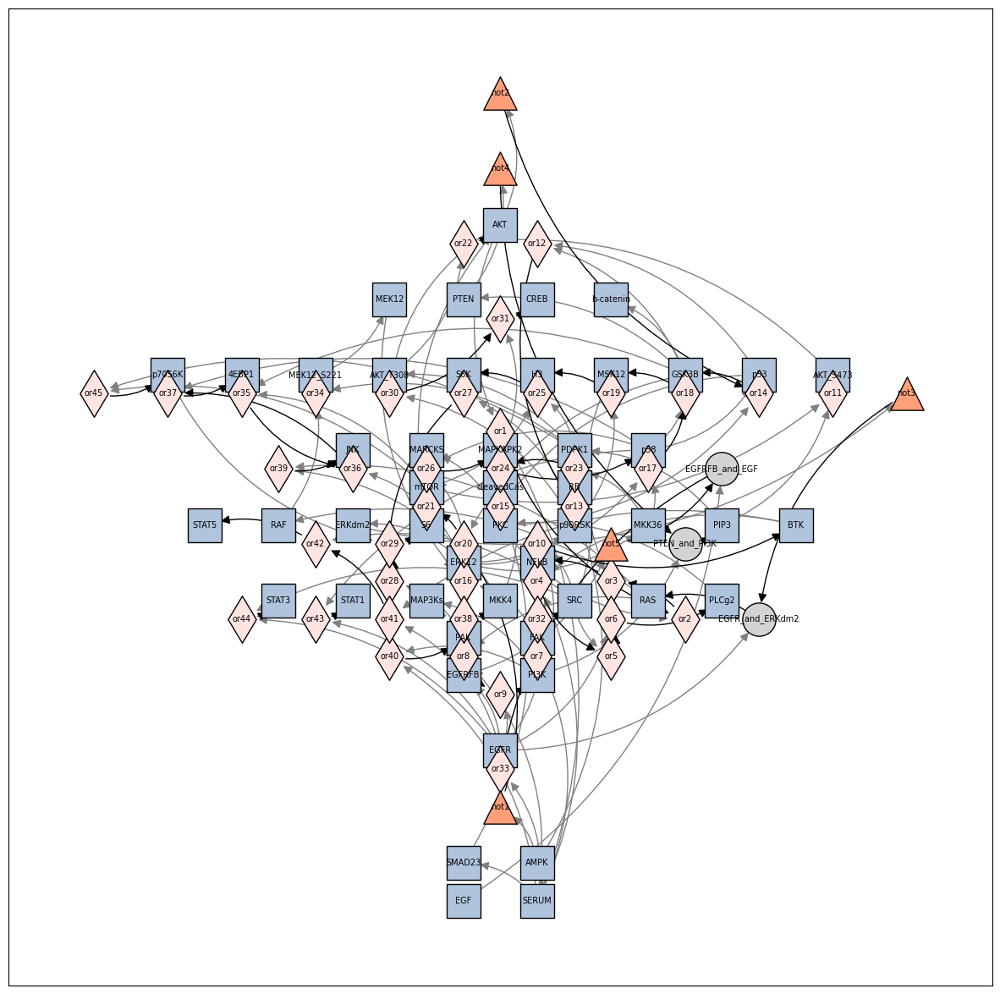

In [3]:
nodes, edges = read_sif("/dccstor/ipc1/CAR/DREAM/DREAMdata/PKN_Alice.sif")
# edges[("JNK", "p53")] = 1
# edges[("mTOR", "p.AKT.Ser473")] = 1
my_model = DREAMBioFuzzNet(nodes, edges)
p = draw_BioFuzzNet(my_model)

In [4]:
my_model.root_nodes

['SERUM', 'EGF']

In [6]:

cl_data = pd.read_csv("/dccstor/ipc1/CAR/DREAM/DREAMdata/ZR7530.csv")
non_marker_cols = ["treatment", "cell_line", "time", "cellID", "fileID", "inhibitor"]

cl_data = cl_data[cl_data["time"]==9]
cl_data.loc[:, ["EGF", "SERUM", "PTEN"]]  = 1
cl_data.loc[:,"inhibitor"] = [inhibitor_mapping[treatment]  for treatment in cl_data["treatment"]]

cl_data = cl_data.rename(columns = node_names_to_data_mapping)

markers = [c for c in cl_data.columns if not c in non_marker_cols]
scaler = MinMaxScaler()
cl_data[markers] = scaler.fit_transform(cl_data[markers])
non_network_measurements = [m for m in markers if m not in node_names_to_data_mapping.values()]
cl_data = cl_data.drop(["treatment", "cell_line", "time", "cellID", "fileID"] + non_network_measurements, axis=1)
cl_data.loc[:, ["EGF", "SERUM", "PTEN"]]  = 1

cl_data

,b-catenin,cleavedCas,4EBP1,AKT_S473,AKT_T308,AMPK,BTK,CREB,ERK12,FAK,...,p70S6K,SMAD23,SRC,STAT1,STAT3,STAT5,EGF,SERUM,inhibitor,PTEN
25595,0.395636,0.402194,0.554408,0.377560,0.180243,0.360751,0.724974,2.961296e-01,0.330656,0.541411,...,0.369775,0.186604,0.383592,0.328056,0.441879,0.340322,1,1,NaN,1
25596,0.000000,0.140044,0.243706,0.465025,0.168604,0.281311,0.473937,1.611169e-07,0.241769,0.507552,...,0.109032,0.478256,0.245605,0.355943,0.169588,0.300694,1,1,NaN,1
25597,0.279084,0.432673,0.643641,0.339079,0.191971,0.327951,0.673063,2.144081e-01,0.388390,0.574907,...,0.563735,0.486540,0.255902,0.368843,0.457316,0.304705,1,1,NaN,1
25598,0.000000,0.267420,0.300175,0.808092,0.000000,0.414030,0.418127,2.696125e-01,0.407983,0.499136,...,0.726091,0.000000,0.398669,0.446374,0.232850,0.345303,1,1,NaN,1
25599,0.530664,0.402922,0.645685,0.541565,0.295295,0.417205,0.850801,3.145570e-01,0.438286,0.696340,...,0.596778,0.634626,0.410794,0.434798,0.531388,0.382133,1,1,NaN,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
438604,0.605812,0.292460,0.723369,0.469619,0.197461,0.376348,0.702688,2.378303e-01,0.343494,0.592003,...,0.554484,0.375520,0.454312,0.329122,0.651206,0.379009,1,1,PKC,1
438605,0.000000,0.000000,0.276717,0.613644,0.064744,0.262601,0.435562,1.284888e-01,0.330554,0.383168,...,0.277070,0.445072,0.132246,0.303992,0.311794,0.383396,1,1,PKC,1
438606,0.584230,0.312458,0.536293,0.567080,0.133814,0.365786,0.560573,2.156951e-01,0.379931,0.788125,...,0.604408,0.340593,0.354785,0.456384,0.446863,0.387726,1,1,PKC,1
438607,0.125551,0.480262,0.601018,0.515862,0.350015,0.409957,0.684871,3.229089e-01,0.427007,0.686195,...,0.653604,0.737798,0.315952,0.361219,0.413430,0.336527,1,1,PKC,1


In [7]:
train, test = train_test_split(cl_data)
print(train.shape)
print(test.shape)
train = train.to_dict("list")
test = test.to_dict("list")

train_data = {k: torch.DoubleTensor(v) for k, v in train.items() if k in markers}
test_data = {k: torch.DoubleTensor(v) for k, v in test.items() if k in markers}

train_inhibitors = {m1: torch.DoubleTensor([10. if m==m1 else 1. for m in train["inhibitor"]]) for m1 in my_model.nodes()}
test_inhibitors = {m1: torch.DoubleTensor([10. if m==m1 else 1. for m in test["inhibitor"]]) for m1 in my_model.nodes()}

input_train = {"SERUM": train["SERUM"], "EGF": train["EGF"], "PTEN": train["PTEN"]}
input_test = {"SERUM": test["SERUM"], "EGF": test["EGF"], "PTEN": test["PTEN"]} 




(43463, 36)
(14488, 36)


In [8]:
# specify some optimisation parameters

learning_rate = 5e-3
epochs = 1
batch_size = 300

In [ ]:
loss = my_model.conduct_optimisation(input = input_train,
                                     valid_input = input_test,
                                     ground_truth=train_data,
                                     valid_ground_truth=test_data,
                                     train_inhibitors = train_inhibitors,
                                     valid_inhibitors = test_inhibitors,
                                     epochs = epochs,
                                     learning_rate= learning_rate,
                                     batch_size= batch_size
                                         )

  0%|          | 0/1 [00:00<?, ?it/s]

SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MS

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
P

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_an

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MS

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37


or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_an

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STA

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MS

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK

not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
o

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STA

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STA

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37


or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCK

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
P

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K


STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37


EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STA

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21


RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
P

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
no

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or

cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12


or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
P

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1

or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12


or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
o

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21


or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
o

p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ER

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or1

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK1

PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
o

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
o

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EG

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EG

STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14

or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3


or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K


or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
B

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6

FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19

ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT

or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLC

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4


S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
o

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26


or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S

or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S22

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MK

or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FA

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EG

or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PT

AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFR

MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20


or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5

MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
o

RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10


not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
o

or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERK

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12


MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SE

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK


not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37


or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40


p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_

or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK

or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
o

or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3


AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T

or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STA

or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP

or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JN

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
clea

MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38


or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
P

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or3

not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-cate

or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2


or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B

not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS


or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or

or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28

4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12
or13
AKT_S473
or25
or45
not3
or18
or26
or37
or34
or39
STAT5
or43
AKT_T308
S6K
or27
or28
cleavedCas
RB
or22
p70S6K
MSK12
or19
MAPKAPK2
or31
or3
4EBP1
MEK12_S221
JNK
STAT1
or29
H3
CREB
NFkB
MEK12
S6
SERUM
EGF
SMAD23
AMPK
or4
or7
or8
or33
EGFRFB_and_EGF
not1
AKT
or1
or5
FAK
EGFR
PI3K
or40
or20
not2
or21
or6
or16
or9
EGFRFB
EGFR_and_ERKdm2
or32
MAP3Ks
PTEN_and_PI3K
or10
PAK
GSK3B
or14
mTOR
PKC
or2
PLCg2
ERK12
not5
RAS
SRC
BTK
or41
or44
or38
PIP3
b-catenin
PTEN
or35
or11
p90RSK
or30
MARCKS
MKK36
ERKdm2
or17
or36
RAF
or23
or42
STAT3
MKK4
PDPK1
or24
p38
p53
or15
not4
or12

<AxesSubplot: xlabel='time', ylabel='loss'>

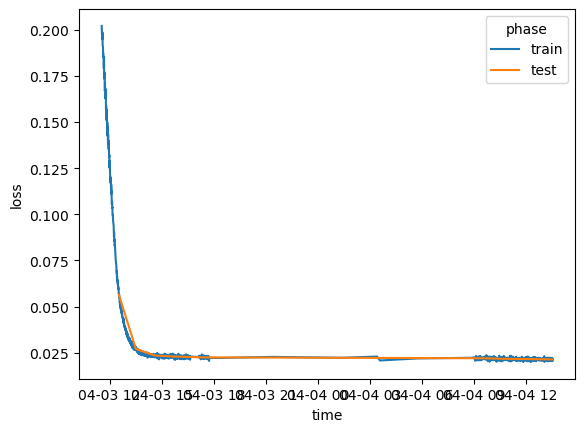

In [9]:
sns.lineplot(data=loss, x='time', y='loss', hue='phase')

In [23]:
len(my_model.output_states["PLCg2"])

14488

Text(0, 0.5, 'True')

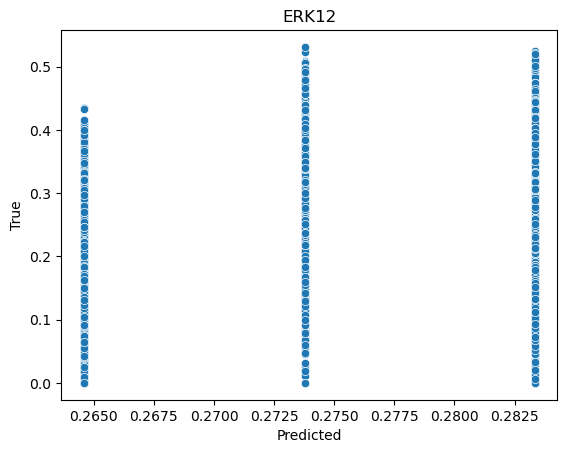

In [22]:
node = "ERK12"
sns.scatterplot(x=my_model.output_states[node], y=test_data[node]).set_title(node)
plt.xlabel("Predicted")
plt.ylabel("True")

In [14]:
my_model.nodes

NodeView(('PIP3', 'AKT_S473', 'p53', 'RB', 'GSK3B', 'AMPK', 'cleavedCas', 'SMAD23', 'ERK12', 'MSK12', 'MKK36', 'H3', 'p90RSK', 'SERUM', '_and_mTOR', 'AKT', 'NFkB', 'cAMP', 'PKA', 'PKC', 'p38', 'PLCg2', 'MET', 'RAF', 'mTOR', 'p70S6K', 'PDPK1', 'AKT_T308', 'MAPKAPK2', 'PTEN', '_or_mTOR', 'b-catenin', 'S6', 'CREB', 'RAS', 'PI3K', 'BTK', 'RAF_S259', 'MARCKS', 'SRC', 'FAK', 'EGFR', 'MEK12_S221', '4EBP1', 'SYK', 'MKK4', 'JNK', 'MAP3Ks', 'INSR', 'PAK', 'STAT5', '_and_RAS', '_and_PIP3', 'EGF', '_and_RAF', 'MEK12', 'STAT1', 'STAT3', 'not1', 'not2', 'not3', 'not4', 'or1', 'or2', 'or3', 'or4', 'or5', 'or6', 'or7', 'or8', 'or9', 'or10', 'or11', 'or12', 'or13', 'or14', 'or15', 'or16', 'or17', 'or18', 'or19', 'or20', 'or21', 'or22', 'or23', 'or24', 'or25', 'or26', 'or27', 'or28', 'or29', 'or30', 'or31', 'or32', 'or33', 'or34', 'or35', 'or36', 'or37', 'or38', 'or39', 'or40', 'or41'))

In [27]:
test_data["PLCg2"].unique()

tensor([0.0000e+00, 6.9965e-05, 2.1480e-04,  ..., 9.3541e-01, 9.6184e-01,
        1.0000e+00])

In [29]:
my_model.output_states["PLCg2"].unique()

tensor([0.3192, 0.3655, 0.3971])

In [ ]:
test

In [ ]:
pickle.dump(my_model, open("/Users/adr/Box/CAR_Tcells/Model/test_"))